# Face Completion With Multi-Estimator Output
# Estimators and Results

This notebook contains all information related to the estimators run, and the results of those runs over the 100 sample example dataset. We will start by writing the basic data load in:

In [2]:
import os
import dask_image.imread
import numpy as np
import matplotlib.pyplot as plt


# Read in pre-processed data and grayscale
fn_pattern = os.path.join('example', 'inputs', 'warpedimagesubset', 'images', f'0*.jpg')
full_pictures = dask_image.imread.imread(fn_pattern)
num_samples = 100

def grayscale(rgb):
    return ((rgb[..., 0] * 0.2126) +
                (rgb[..., 1] * 0.7152) +
                (rgb[..., 2] * 0.0722))


data = grayscale(full_pictures)

# Cut data to top and bottom halfs and convert to np.array
# Also cut into training and test
half = 64
cut_off = int(num_samples * .8)
X_train = data[:cut_off, :half, :].compute()
y_train = data[:cut_off, half:, :].compute()
X_test = data[cut_off:num_samples, :half, :].compute()
y_test = data[cut_off:num_samples, half:, :].compute()
# Flatten data for estimators
X_train = np.array([i[:].flatten() for i in X_train])
y_train = np.array([i[:].flatten() for i in y_train])
X_test = np.array([i[:].flatten() for i in X_test])
y_test = np.array([i[:].flatten() for i in y_test])
# Create dictionary for results
y_predictions = {}

# Quick functions to display all 20 test images
def remake_image(test, train):
    full = np.hstack((test, train))
    return full.reshape((128, 128))


def plot_images(y_used):
    fig = plt.figure(figsize=(400,400))
    grid = fig.add_gridspec(4, 5, wspace=0, hspace=0)
    for idx in range(20):
        this_ax = fig.add_subplot(grid[int(idx/5), idx%4])
        this_ax.set(xticks=[], yticks=[])
        this_img = remake_image(X_test[idx], y_used[idx])
        this_ax.imshow(this_img, cmap='Greys_r')
    plt.show()
    

# Plot the actual images
plot_images(y_test)

Create two "worst case" baselines. Both are made of random predictions: one that randomly predicts over the training data and one that is completely random noise.

In [3]:
import random as rand

y_predictions['complete_random'] = np.random.randint(low=0, high=256, size=(20, 8192))
y_predictions['train_random'] = [rand.choice(y_train) for _ in range(20)]

plot_images(y_predictions['complete_random'])
plot_images(y_predictions['train_random'])

## Linear Regression
Linear regression is the only single output regressor that is able to perform without causing memory issues. It does fairly well on faces closer to the "average", i.e. faces looking directly the camera. The more an image is an outlier, the more strange artifacts that are produced. When tested on higher samples, the model tends to do this for all images.

In [4]:
from sklearn.linear_model import LinearRegression

# Create a boiler plate function to run and test
# Saves like maybe 1 line of code
def train_and_test_model(model, name):
    model = model
    model.fit(X_train, y_train)
    y_predictions[name] = model.predict(X_test)

    
# Run it on Linear Regression
train_and_test_model(LinearRegression(), "linear_regression")

# Plot the images
plot_images(y_predictions['linear_regression'])

## Estimator SVM
Running this unfortunately caused massive memory issues, and caused a total system failure.

In [5]:
# REMOVED: NUKED NOTEBOOK

## K-Nearest Neighbors
We will run this over 3 different K's, with varying results.

### K-NN, k = 1
K-NN1 is occaionally extremely accurate, as is the the case with the first image. On this low of a sample size, however, it just as often produces jarring results. Much better results are seen on higher sample sizes, as one would expect.

In [6]:
from sklearn.neighbors import KNeighborsRegressor as KNN

train_and_test_model(KNN(n_neighbors=1), "knn1")

# Plot the images
plot_images(y_predictions['knn1'])

### K-NN, k = 5
K-nn at 5 neighbors actually performs very well, without making the image overly blurry. The worst case scenario at K-nn 1, where the output face is looking the wrong direction, is no longer seen with 5 neighbors. While the pictures are no longer as clear, they are still on the whole more accurate.

In [7]:
train_and_test_model(KNN(n_neighbors=5), "knn5")

# Plot the images
plot_images(y_predictions['knn5'])

### K-nn, k = 15
K-nn with 15 neighbors is likely technically more accurate, but it manages to underfit the data to do this. This would obviously be less of the case if there was more samples, but here 15 neighbors is nearly 20% of the data.

In [8]:
train_and_test_model(KNN(n_neighbors=15), "knn15")

# Plot the images
plot_images(y_predictions['knn15'])

##  Decision Tree
To get the decision tree to converge in a timely manner, we unfortunately need to set max_features to log2. Because of this, Decision Trees don't get a good result. Similar to K-nn1, this model will pick a single face. However, it does so much less accurately than K-nn1.

In [9]:
from sklearn.tree import DecisionTreeRegressor

train_and_test_model(DecisionTreeRegressor(max_features='log2'), 'dec_tree')
plot_images(y_predictions['dec_tree'])

## Random Forest
Random forest, on the other hand, has very good accuracy compared to the rest of the image. It does still have the blurring effect, unfortunately, but overall it manages to produce close to a convincing result for many of the test cases.

In [10]:
from sklearn.ensemble import RandomForestRegressor

train_and_test_model(RandomForestRegressor(n_estimators=10, max_features='log2'), 'ran_for')
plot_images(y_predictions['ran_for'])

## Multi-Layer Perceptron
Multi-Layer Perceptron serves as a basic deep learning comparison. It has a tendency to underfit the data, creating nearly the same face in most cases. It does do well at maintaining the overall brightness.

In [11]:
from sklearn.neural_network import MLPRegressor
train_and_test_model(MLPRegressor(max_iter=5000), 'mlp')
plot_images(y_predictions['mlp'])

## Pluralistic Image Completion 
I am unable to run this neural network in a notebook, unfortunately. This is due to the fact that the authors set variables by passing around `opts` from `argparse`, interfering with the internals of Jupyter. I have made a decent amount of changes to code base itself, but changing this would require basically every part of the code to use some other object. The GitHub for PIC can be found here: https://github.com/lyndonzheng/Pluralistic-Inpainting

# Results
While we can't get results from PIC, we can still analyze the results from the rest of estimators. To get these results over 100 samples, we will run KFolds with K=5. Then we will calculate the MSE and MAE, and compare to the worst case scenarios. 

In [12]:
estimators = {
    "Linear Regression": LinearRegression(),
    "1K-nn": KNN(n_neighbors=1),
    "5K-nn": KNN(n_neighbors=5,),
    "15K-nn": KNN(n_neighbors=15, weights='distance'),
    "Decision Tree": DecisionTreeRegressor(max_features='log2'),
    "Random Forest": RandomForestRegressor(n_estimators=10, max_features='log2'),
    "MLP Regressor": MLPRegressor(max_iter=5000)
}

trains = [X_train[:20], X_train[20:40], X_train[40:60], X_train[60:80], X_test]
tests = [y_train[:20], y_train[20:40], y_train[40:60], y_train[60:80], y_test]
fold_predictions = {}

for fold in range(5):
    this_x_train = np.vstack((trains[(fold+1)%5], trains[(fold+2)%5], trains[(fold+3)%5],
                              trains[(fold+4)%5]))
    this_y_train = np.vstack((tests[(fold+1)%5], tests[(fold+2)%5], tests[(fold+3)%5],
                              tests[(fold+4)%5]))
    this_x_test = trains[fold]
    this_y_test = tests[fold]
    for name, est in estimators.items():
        est.fit(this_x_train, this_y_train)
        this_pred = est.predict(this_x_test)
        try:
            fold_predictions[name].append(this_pred)
        except KeyError:
            fold_predictions[name] = [this_pred]
    try:
        fold_predictions['Complete Random'].append(
            np.random.randint(low=0, high=256, size=(20, 8192)))
        fold_predictions['Train Random'].append(
            [rand.choice(this_y_train) for _ in range(20)])
    except KeyError:
        fold_predictions['Complete Random'] = \
            [np.random.randint(low=0, high=256, size=(20, 8192))]
        fold_predictions['Train Random'] = \
            [[rand.choice(this_y_train) for _ in range(20)]]
        

print('Complete')

Complete


In [13]:
import sklearn.metrics as metrics

order_estimators = [
    'Complete Random',
    'Train Random',
    'Linear Regression',
    '1K-nn',
    '5K-nn',
    '15K-nn',
    'Decision Tree',
    'Random Forest',
    'MLP Regressor'
]

maes = {}
mses = {}

for i in order_estimators:
    maes[i] = []
    mses[i] = []

    for j in range(5):
        mae = metrics.mean_absolute_error(tests[j], fold_predictions[i][j])
        mse = metrics.mean_squared_error(tests[j], fold_predictions[i][j])
        maes[i].append(mae)
        mses[i].append(mse)

print('Complete')

Complete


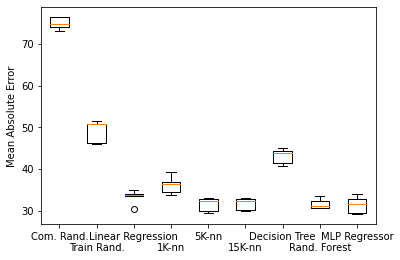

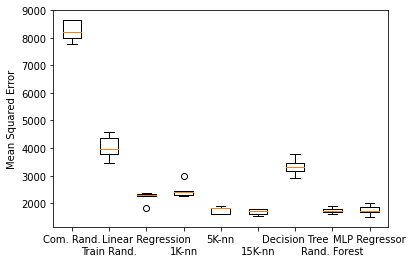

In [14]:
nice_estimators = [
    'Com. Rand.',
    '\nTrain Rand.',
    'Linear Regression',
    '\n1K-nn',
    '5K-nn',
    '\n15K-nn',
    'Decision Tree',
    '\nRand. Forest',
    'MLP Regressor'
]
values = [maes[i] for i in order_estimators]
plt.boxplot(values)
plt.xticks(range(1, len(order_estimators) + 1), nice_estimators)
plt.ylabel('Mean Absolute Error')
plt.show()

values = [mses[k] for k in order_estimators]
plt.boxplot(values)
plt.xticks(range(1, len(order_estimators) + 1), nice_estimators)
plt.ylabel('Mean Squared Error')
plt.show()

In [15]:
import sklearn.metrics as metrics

order_estimators = [
    'Complete Random',
    'Train Random',
    'Linear Regression',
    '1K-nn',
    '5K-nn',
    '15K-nn',
    'Decision Tree',
    'Random Forest',
    'MLP Regressor'
]

maes = {}
mses = {}

for i in order_estimators:
    maes[i] = []
    mses[i] = []

    for j in range(5):
        mae = metrics.mean_absolute_error(tests[j], fold_predictions[i][j])
        mse = metrics.mean_squared_error(tests[j], fold_predictions[i][j])
        maes[i].append(mae)
        mses[i].append(mse)

print('Complete')

Complete


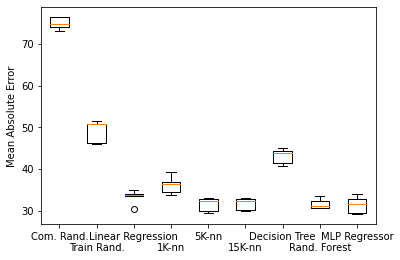

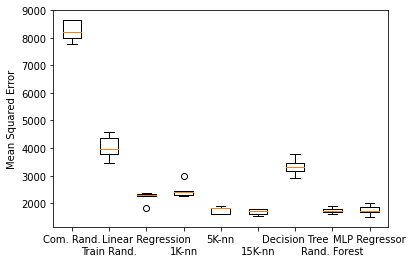

In [16]:
nice_estimators = [
    'Com. Rand.',
    '\nTrain Rand.',
    'Linear Regression',
    '\n1K-nn',
    '5K-nn',
    '\n15K-nn',
    'Decision Tree',
    '\nRand. Forest',
    'MLP Regressor'
]
values = [maes[i] for i in order_estimators]
plt.boxplot(values)
plt.xticks(range(1, len(order_estimators) + 1), nice_estimators)
plt.ylabel('Mean Absolute Error')
plt.show()

values = [mses[k] for k in order_estimators]
plt.boxplot(values)
plt.xticks(range(1, len(order_estimators) + 1), nice_estimators)
plt.ylabel('Mean Squared Error')
plt.show()

## Results analysis
These results show that none of our estimators come close to the worst case, even on a small smaple size. On the smaller sample size, MLP Regressor performs much better, comparatively, then it did over 1000x10 samples after being trained on 20000 samples. 

Outside of that, the estimators perform about how one would expect. With the low amount of max features passed to it, Decision Trees perform closest to the worst case. The techniques that blur the image do the best, as they're able to minimize the error by having a more average value. Linear regression performed surprising well, but still produces strange artifacts in its images.

[Return Home](./project_home.ipynb).

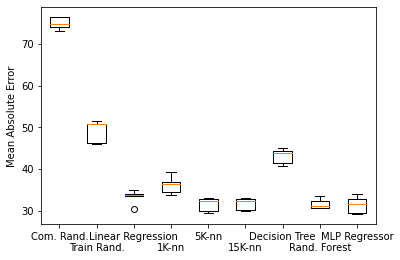

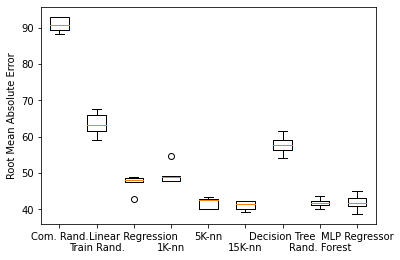

In [19]:
values1 = [maes[i] for i in order_estimators]
plt.boxplot(values1)
plt.xticks(range(1, len(order_estimators) + 1), nice_estimators)
plt.ylabel('Mean Absolute Error')
plt.show()

values2 = [np.sqrt(mses[i]) for i in order_estimators]
plt.boxplot(values2)
plt.xticks(range(1, len(order_estimators) + 1), nice_estimators)
plt.ylabel('Root Mean Absolute Error')
plt.show()